In [1]:
import sys
import pandas as pd
import numpy as np

housing = pd.read_csv("housing.csv")


In [2]:
housing.shape

(20640, 10)

In [3]:
housing.head()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity
0,-122.23,37.88,41.0,880.0,129.0,322.0,126.0,8.3252,452600.0,NEAR BAY
1,-122.22,37.86,21.0,7099.0,1106.0,2401.0,1138.0,8.3014,358500.0,NEAR BAY
2,-122.24,37.85,52.0,1467.0,190.0,496.0,177.0,7.2574,352100.0,NEAR BAY
3,-122.25,37.85,52.0,1274.0,235.0,558.0,219.0,5.6431,341300.0,NEAR BAY
4,-122.25,37.85,52.0,1627.0,280.0,565.0,259.0,3.8462,342200.0,NEAR BAY


In [4]:
housing.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20640 entries, 0 to 20639
Data columns (total 10 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   longitude           20640 non-null  float64
 1   latitude            20640 non-null  float64
 2   housing_median_age  20640 non-null  float64
 3   total_rooms         20640 non-null  float64
 4   total_bedrooms      20433 non-null  float64
 5   population          20640 non-null  float64
 6   households          20640 non-null  float64
 7   median_income       20640 non-null  float64
 8   median_house_value  20640 non-null  float64
 9   ocean_proximity     20640 non-null  object 
dtypes: float64(9), object(1)
memory usage: 1.6+ MB


In [5]:
housing["ocean_proximity"].value_counts()

<1H OCEAN     9136
INLAND        6551
NEAR OCEAN    2658
NEAR BAY      2290
ISLAND           5
Name: ocean_proximity, dtype: int64

In [6]:
housing.describe()


,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value
count,20640.000000,20640.000000,20640.000000,20640.000000,20433.000000,20640.000000,20640.000000,20640.000000,20640.000000
mean,-119.569704,35.631861,28.639486,2635.763081,537.870553,1425.476744,499.539680,3.870671,206855.816909
std,2.003532,2.135952,12.585558,2181.615252,421.385070,1132.462122,382.329753,1.899822,115395.615874
min,-124.350000,32.540000,1.000000,2.000000,1.000000,3.000000,1.000000,0.499900,14999.000000
25%,-121.800000,33.930000,18.000000,1447.750000,296.000000,787.000000,280.000000,2.563400,119600.000000
50%,-118.490000,34.260000,29.000000,2127.000000,435.000000,1166.000000,409.000000,3.534800,179700.000000
75%,-118.010000,37.710000,37.000000,3148.000000,647.000000,1725.000000,605.000000,4.743250,264725.000000
max,-114.310000,41.950000,52.000000,39320.000000,6445.000000,35682.000000,6082.000000,15.000100,500001.000000


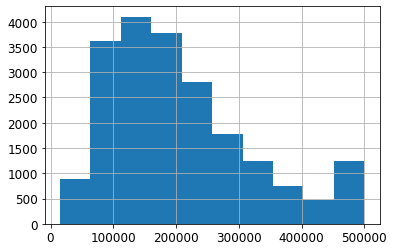

In [7]:
#median_house_value histogram
%matplotlib inline
import matplotlib as mpl
import matplotlib.pyplot as plt
mpl.rc('axes', labelsize=14)
mpl.rc('xtick', labelsize=12)
mpl.rc('ytick', labelsize=12) 
housing["median_house_value"].hist()

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x000001668FF9A6D8>,
      dtype=object)

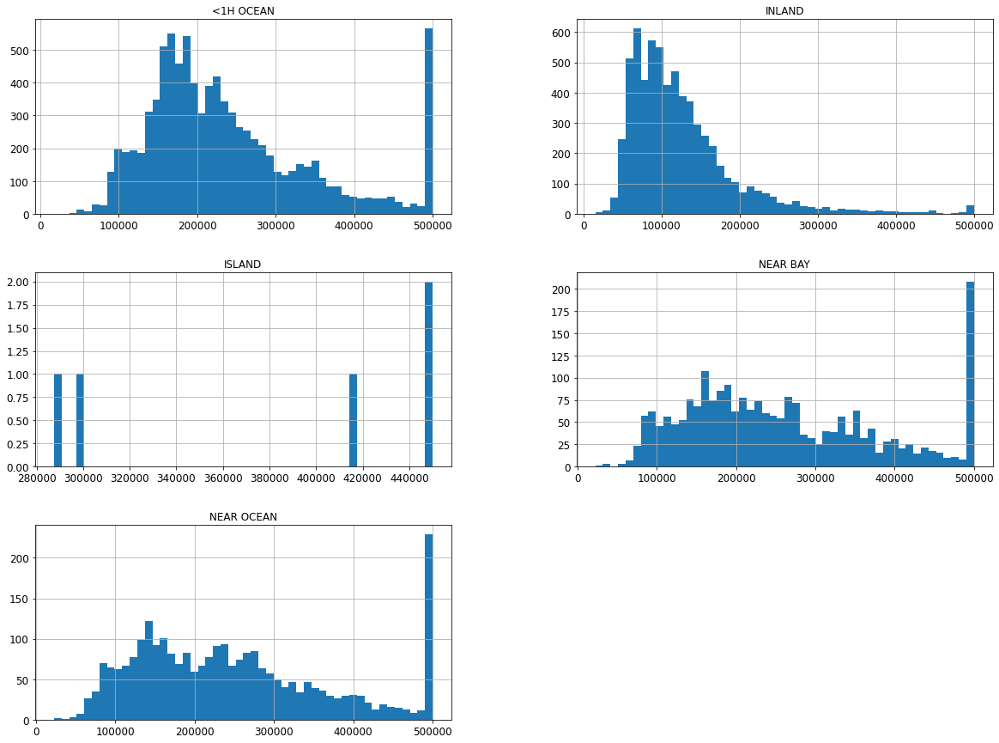

In [8]:
#histograms according to different ocean_proximities
vals = housing.pivot(index=None, columns="ocean_proximity", values="median_house_value")
vals.hist(bins=50, figsize=(20,15))

In [9]:
from sklearn.model_selection import train_test_split
# randomly select the test set
train_set, test_set = train_test_split(housing, test_size=0.2)

In [10]:
from sklearn.model_selection import StratifiedShuffleSplit

#make income categorical to do stratified sampling
housing["income_cat"] = pd.cut(housing["median_income"], bins=[0., 1.5, 3., 4.5, 6., np.inf], labels=[1, 2, 3, 4, 5])

split = StratifiedShuffleSplit(n_splits=1, test_size=0.2)
for train_index, test_index in split.split(housing, housing["income_cat"]):
    strat_train = housing.loc[train_index]
    strat_test = housing.loc[test_index]

In [11]:
#drop income_cat variable
strat_train.drop("income_cat", axis=1, inplace=True)
strat_test.drop("income_cat", axis=1, inplace=True)
housing = strat_train.copy()

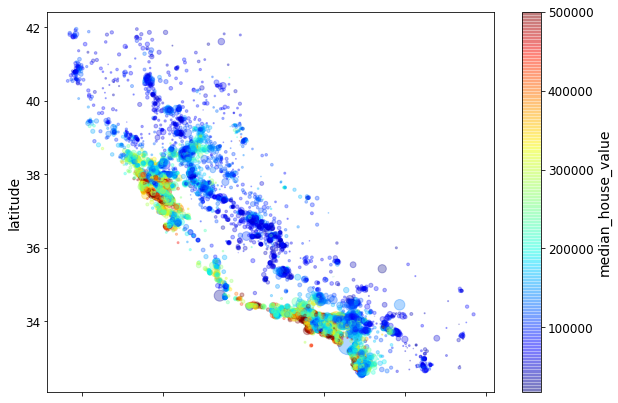

In [12]:
housing.plot(kind="scatter", x="longitude", y="latitude", figsize=(10,7), alpha=0.3, s=housing["population"]/100, c="median_house_value", cmap=plt.get_cmap("jet"), colorbar=True)

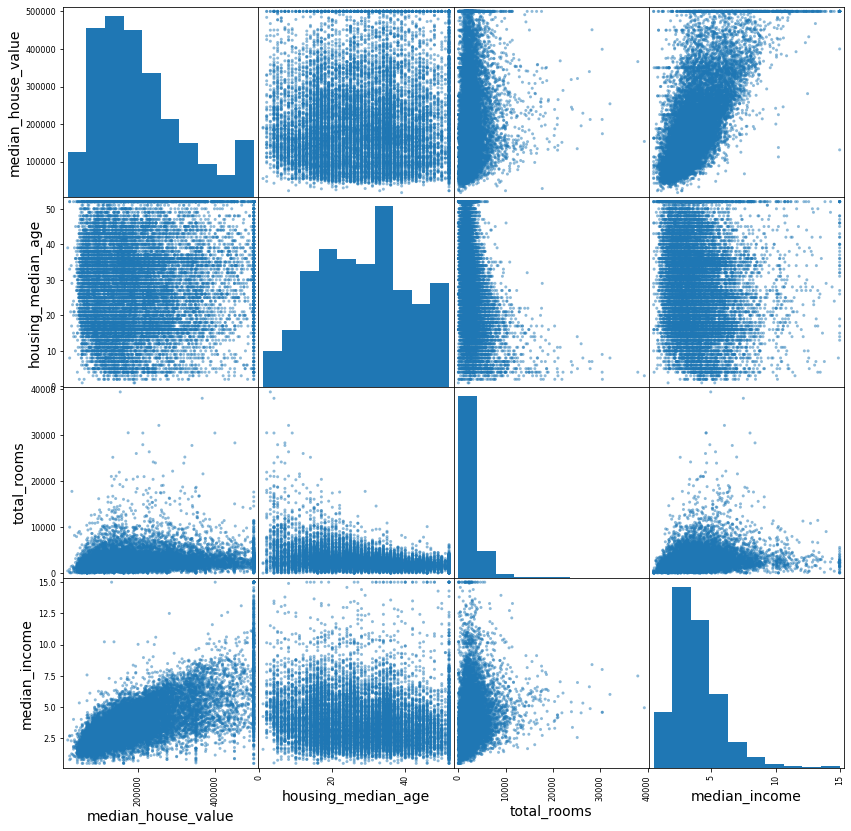

In [13]:
from pandas.plotting import scatter_matrix

atts = ["median_house_value", "housing_median_age", "total_rooms", "median_income"]
_ = scatter_matrix(housing[atts], figsize=(14, 14))

In [14]:
# special attributes
housing["rooms_per_household"] = housing["total_rooms"]/housing["households"]
housing["bedrooms_per_room"] = housing["total_bedrooms"]/housing["total_rooms"]
housing["population_per_household"] = housing["population"]/housing["households"]

In [15]:
#find correlations
cormat = housing.corr()
cormat.median_house_value.sort_values()


bedrooms_per_room          -0.253511
latitude                   -0.144482
longitude                  -0.046602
population                 -0.025141
population_per_household   -0.022594
total_bedrooms              0.050080
households                  0.065531
housing_median_age          0.110296
total_rooms                 0.135247
rooms_per_household         0.152883
median_income               0.686292
median_house_value          1.000000
Name: median_house_value, dtype: float64

In [16]:
#split dependent and independent variables
housing = strat_train.drop("median_house_value", axis=1)
housing_labels = strat_train.median_house_value.copy()

In [ ]:
# impute missin values
from sklearn.impute import SimpleImputer

#give it missing values, strategies and so on
imputer = SimpleImputer(strategy="median", )
#need to drop categorical variable to find median
housing_num = housing.drop("ocean_proximity", axis=1)
#fit imputer on *training set*
imputer.fit(housing_num)

In [ ]:
#now use the _fitted_ imputer to _transform_ the data in hand
X = imputer.transform(housing_num) #this is a numpy array
#convert it to pandas df again
housing_tr = pd.DataFrame(X, columns=housing_num.columns, index=housing_num.index)


Learn Scikit structure from book page $103$

In [ ]:
# now we will deal with categorical variables
from sklearn.preprocessing import OrdinalEncoder
ord_encoder = OrdinalEncoder()
housing_cat = ord_encoder.fit_transform(housing.ocean_proximity.to_frame())

In [ ]:
ord_encoder.categories_

In [ ]:
#BUT we need one-hot-encoder for this case
from sklearn.preprocessing import OneHotEncoder
cat_encoder = OneHotEncoder()
housing_cat = cat_encoder.fit_transform(housing.ocean_proximity.to_frame())
housing_cat

## Let's try Custom Transformars!!

In [17]:
from sklearn.base import BaseEstimator, TransformerMixin

#transformer to add scaled features
class Attr1Adder(BaseEstimator, TransformerMixin):
    def __init__(self, add_bed_per_room=True):
        self.add_bed_per_room = add_bed_per_room
    
    def fit(self, X, y=None):
        return self
    
    def transform(self, X, y=None):
        rooms_ix, bedrooms_ix, population_ix, households_ix = 3, 4, 5, 6
        rooms_per_household = X[:, rooms_ix] / X[:, households_ix]
        population_per_household = X[:,  population_ix] / X[:, households_ix]
        if self.add_bed_per_room:
            bedrooms_per_room = X[:, bedrooms_ix] / X[:, rooms_ix]
            return np.c_[X, rooms_per_household, population_per_household, bedrooms_per_room]
        else:
            return np.c_[X, rooms_per_household, population_per_household]



In [18]:
housing_num = housing.drop("ocean_proximity", axis=1)
att1_adder = Attr1Adder(add_bed_per_room=False)
housing_ext_attr = att1_adder.transform(X=housing_num.values)

## Let's go pipelines

In [19]:
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import OneHotEncoder

numline = Pipeline([
    ('imputer', SimpleImputer(strategy="median")),
    ('att1adder', Attr1Adder()),
    ('std_scaler', StandardScaler()),
])

# add categorical transformations using column transformer

from sklearn.compose import ColumnTransformer


num_atts = housing.columns.to_list()
cat_atts = [num_atts.pop()]

full_pipeline = ColumnTransformer([ #this is actually a transformer, not a pipeline
    ('num', numline, num_atts),
    ('cat', OneHotEncoder(), cat_atts),
])

housing_prp = full_pipeline.fit_transform(housing)

## Fit a linear regressor

In [20]:
from sklearn.linear_model import LinearRegression

lin_reg =LinearRegression()
lin_reg.fit(housing_prp, housing_labels)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)

In [21]:
#predictions
test_data = strat_test.drop("median_house_value", axis=1)
test_label = strat_test.median_house_value
test_data_prp = full_pipeline.transform(test_data)
preds = lin_reg.predict(test_data_prp)
#find adjusted r^2 now
lin_reg.score(test_data_prp, test_label)


0.6445706217800529

In [22]:
from sklearn.metrics import mean_squared_error

np.sqrt(mean_squared_error(test_label, preds))

68228.96316160874

## Decision Tree

In [23]:
from sklearn.tree import DecisionTreeRegressor

dec_tree = DecisionTreeRegressor()
dec_tree.fit(housing_prp, housing_labels) 

DecisionTreeRegressor(ccp_alpha=0.0, criterion='mse', max_depth=None,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=None, splitter='best')

## Random forest

In [24]:
from sklearn.ensemble import RandomForestRegressor

forest = RandomForestRegressor()
forest.fit(housing_prp, housing_labels)

RandomForestRegressor(bootstrap=True, ccp_alpha=0.0, criterion='mse',
                      max_depth=None, max_features='auto', max_leaf_nodes=None,
                      max_samples=None, min_impurity_decrease=0.0,
                      min_impurity_split=None, min_samples_leaf=1,
                      min_samples_split=2, min_weight_fraction_leaf=0.0,
                      n_estimators=100, n_jobs=None, oob_score=False,
                      random_state=None, verbose=0, warm_start=False)

## Cross validation

In [25]:
from sklearn.model_selection import cross_val_score

scores = cross_val_score(dec_tree, housing_prp, housing_labels, scoring="neg_mean_squared_error", cv=10)

print(f"{scores.mean()}\n{np.sqrt(scores.std())}")

-5124706616.11792
17193.860331425745


## Fine tune using Grid Search

In [26]:
from sklearn.model_selection  import GridSearchCV

param_grid = [
    {'n_estimators': [3, 10, 30], 'max_features': [2 ,4, 6, 8]},
    {'bootstrap': [False], 'n_estimators': [3, 10], 'max_features': [2, 3, 4]},
]

forest = RandomForestRegressor()

grids = GridSearchCV(forest, param_grid, scoring="neg_mean_squared_error", return_train_score=True, cv=5)

grids.fit(housing_prp, housing_labels)

GridSearchCV(cv=5, error_score=nan,
             estimator=RandomForestRegressor(bootstrap=True, ccp_alpha=0.0,
                                             criterion='mse', max_depth=None,
                                             max_features='auto',
                                             max_leaf_nodes=None,
                                             max_samples=None,
                                             min_impurity_decrease=0.0,
                                             min_impurity_split=None,
                                             min_samples_leaf=1,
                                             min_samples_split=2,
                                             min_weight_fraction_leaf=0.0,
                                             n_estimators=100, n_jobs=None,
                                             oob_score=False, random_state=None,
                                             verbose=0, warm_start=False),
             iid='deprecated', n_jo

In [27]:
grids.best_params_

{'max_features': 8, 'n_estimators': 30}

## Full model pipeline

In [37]:
#we already have the pipeline(!transformation) to clean the data, just need to add final model

class ForestPredictor(BaseEstimator, TransformerMixin):
    def __init__(self):
        self.model = grids.best_estimator_
    def fit(self, X=None):
        return self
    def transform(self, X):
        return self.model.predict(X)

clean_and_train = Pipeline([
    ('cleandata', full_pipeline), #transformer object
    ('forest', ForestPredictor()),
    ])

In [47]:
  pipeline_preds = clean_and_train.transform(test_data)

-7413527.434427261

In [49]:
import joblib

joblib.dump( grids.best_estimator_, 'best_predictor.pkl')

['best_predictor.pkl']

In [50]:
import dill

dill.dump_session('final_session.db')

In [ ]:
import dill

dill.load_session('final_session.db')

In [ ]:
import joblib

joblib.load('best_predictor.p')